## Imports

In [1]:
# from astroquery.gaia import Gaia
from astropy.io.votable import parse
from astropy import units as u
from astropy.coordinates import SkyCoord
from sklearn.neighbors import NearestNeighbors
import scipy as sp
from scipy.spatial import distance
from scipy import stats
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from functions import * 
# import mpl_scatter_density
from matplotlib.colors import LinearSegmentedColormap
from scipy.optimize import curve_fit
from sklearn.mixture import GaussianMixture
from sklearn.cluster import DBSCAN
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, f1_score
from sklearn.cluster import AgglomerativeClustering
from sklearn.preprocessing import normalize, StandardScaler
import scienceplots
import networkx as nx
from astropy.io.votable import parse_single_table
# import mplcursors


import warnings
warnings.filterwarnings('ignore')

----

In [2]:
cluster_name = "NGC_2682"
name_title = "NGC2682"

## Data

In [3]:
import os

path = f"../MST PAPER DATA/{cluster_name}"

# Check if the directory exists, if not, create it
if not os.path.exists(path):
    os.makedirs(path)
    print(f"Directory {path} created")
else:
    print(f"Directory {path} already exists")

Directory ../MST PAPER DATA/NGC_2682 already exists


In [4]:
Clusters = pd.read_excel("../Clusters.xlsx", index_col=0)

In [5]:
new_cluster = {"Name": f"{cluster_name}", 
               "init_data": 0,
               "init_filter": 0,
               "mst_cut": 0,
               "mst_filter": 0,
               "gmm_filter": 0,
               "prob_80":0,
               "ra":0, "dec":0, "pmra":0, "pmdec":0, "plx":0, 
               "ra_error":0, "dec_error":0, "pmra_error":0, "pmdec_error":0, "plx_error":0
              }

In [6]:
# df = table.to_table().to_pandas()
# del table

In [7]:
df = pd.read_parquet("./NGC_2682/NGC_2682_(2deg)-result.parquet")

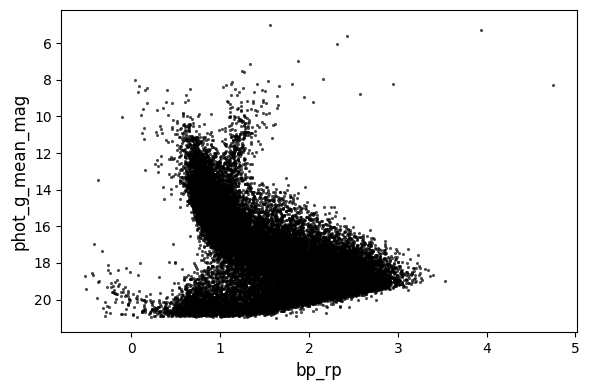

In [8]:
cmd_plot(data=df, x_axis='bp_rp', y_axis='phot_g_mean_mag', s=5, alpha=.7)

In [9]:
df.columns

Index(['DESIGNATION', 'SOURCE_ID', 'ra', 'ra_error', 'dec', 'dec_error',
       'parallax', 'parallax_error', 'pm', 'pmra', 'pmra_error', 'pmdec',
       'pmdec_error', 'ruwe', 'phot_g_mean_flux_error', 'phot_g_mean_mag',
       'phot_bp_mean_flux_error', 'phot_bp_mean_mag',
       'phot_rp_mean_flux_error', 'phot_rp_mean_mag', 'bp_rp', 'bp_g', 'g_rp',
       'radial_velocity', 'phot_variable_flag', 'l', 'b', 'non_single_star',
       'has_xp_continuous', 'has_xp_sampled', 'has_rvs',
       'has_epoch_photometry', 'has_epoch_rv', 'has_mcmc_gspphot',
       'has_mcmc_msc', 'teff_gspphot', 'logg_gspphot', 'mh_gspphot',
       'distance_gspphot', 'azero_gspphot', 'ag_gspphot', 'ebpminrp_gspphot'],
      dtype='object')

In [10]:
len(df)

31288

In [11]:
new_cluster["init_data"] = len(df)

----


# MST Method


## 1. Initial Filters on Data

In [12]:
df_init = df.drop(['ra_error', 'dec_error',
       'pmra_error', 
       'pmdec_error', 'ruwe', 'phot_g_mean_flux_error', 
       'phot_bp_mean_flux_error', 'phot_bp_mean_mag',
       'phot_rp_mean_flux_error', 'phot_rp_mean_mag',
       'radial_velocity', 'phot_variable_flag', 'non_single_star',
       'has_xp_continuous', 'has_xp_sampled', 'has_rvs',
       'has_epoch_photometry', 'has_epoch_rv', 'has_mcmc_gspphot',
       'has_mcmc_msc', 'teff_gspphot', 'logg_gspphot', 'mh_gspphot',
       'distance_gspphot', 'azero_gspphot', 'ag_gspphot', 'ebpminrp_gspphot'], axis=1).dropna(axis=0)

df_init = df_init[df_init['parallax_error'] < 0.25]

In [13]:
len(df_init)

20134

In [14]:
# Initial Filter on PMRA and PMDEC 

def filter_proper_motion(data, pmra, pmdec, d_pmra=2, d_pmdec=2):
    return data[(abs(data['pmra'] - pmra) < abs(d_pmra * pmra)) & (abs(data['pmdec'] - pmdec) < abs(d_pmdec * pmdec))]

def filter_parallax(data, parallax, delta = .2):
    return data[(abs(data['parallax'] -  parallax) < abs(delta * parallax))]

In [15]:
df_init = filter_proper_motion(df_init, -10.9651835, -2.90571303, .5, .5)
df_init = filter_parallax(df_init, 1.15008072, 0.5)

In [16]:
len(df_init)

2279

In [17]:
new_cluster["init_filter"] = len(df_init)

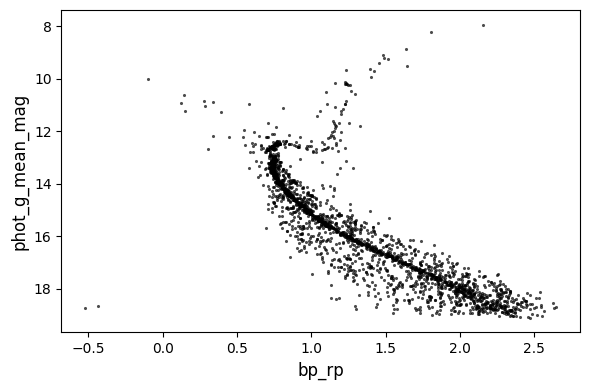

In [18]:
cmd_plot(data = df_init, x_axis = 'bp_rp', y_axis = 'phot_g_mean_mag', s = 5, alpha = .7)

-----

## 2. MST

In [19]:
params = ['ra', 'dec', 'parallax']

In [20]:
scaler = StandardScaler()
x_scaled = scaler.fit_transform(df_init[params])

df_scaled = pd.DataFrame(data=x_scaled, columns=params)
df_scaled['SOURCE_ID'] = df_init['SOURCE_ID'].values

threshold: 0.69


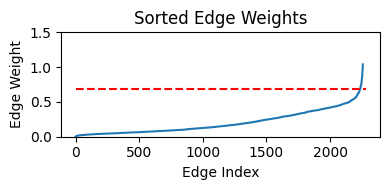

In [21]:
thresh, df_scaled = min_span_tree(df_scaled, params=params, num_std=3, manual_th=0, threshold=.8, y_limit=1.5, fig=True)

In [22]:
new_cluster["mst_cut"] = thresh

In [23]:
print(len(df_scaled[df_scaled['MST_cluster']==1]))
print(len(df_scaled[df_scaled['MST_cluster']==0]))

1826
453


In [24]:
new_cluster["mst_filter"] = len(df_scaled[df_scaled['MST_cluster']==1])

In [25]:
df_mst = df_init.merge(df_scaled[["MST_cluster", "SOURCE_ID"]], on='SOURCE_ID', how='left')

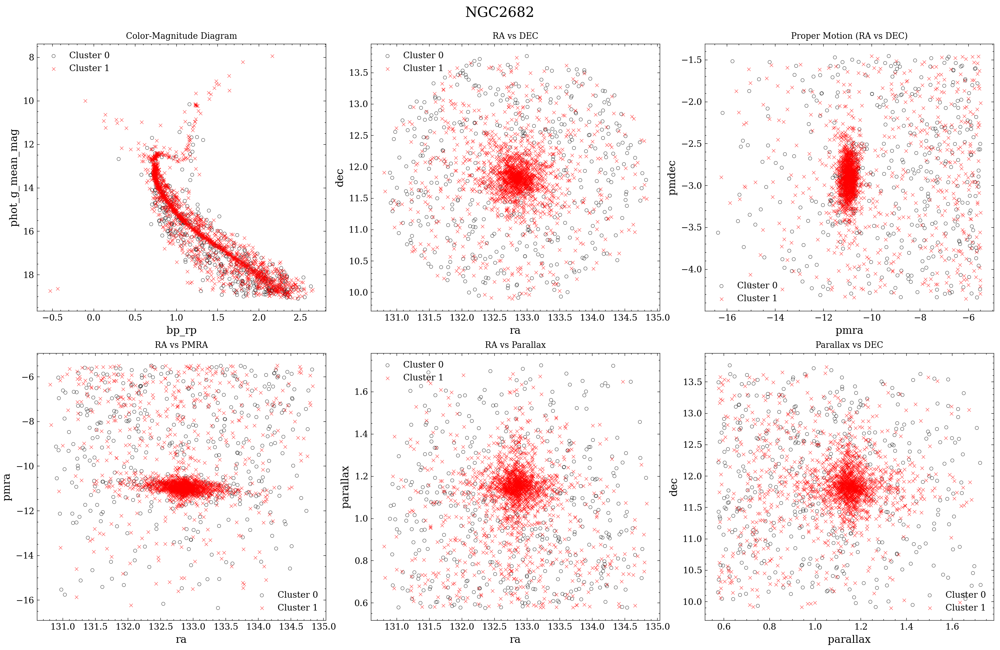

In [26]:
with plt.style.context(['science', 'ieee', 'no-latex']):
    fig, axes = plt.subplots(2, 3, figsize=(16, 10), dpi=200)

    # First row
    cmd_plotly(df_mst, 'bp_rp', 'phot_g_mean_mag', huex='MST_cluster', 
               s=15, alpha=.99, ax=axes[0, 0], theme={1: 'red', 0: 'black'})
    axes[0, 0].set_title('Color-Magnitude Diagram')

    cmd_plotly(df_mst, 'ra', 'dec', huex='MST_cluster', 
               s=15, alpha=.99, ax=axes[0, 1], theme={1: 'red', 0: 'black'}, invert_yaxis=False)
    axes[0, 1].set_title('RA vs DEC')

    cmd_plotly(df_mst, 'pmra', 'pmdec', huex='MST_cluster', 
               s=15, alpha=.99, ax=axes[0, 2], theme={1: 'red', 0: 'black'}, invert_yaxis=False)
    axes[0, 2].set_title('Proper Motion (RA vs DEC)')

    # Second row
    cmd_plotly(df_mst, 'ra', 'pmra', huex='MST_cluster', 
               s=15, alpha=.99, ax=axes[1, 0], theme={1: 'red', 0: 'black'}, invert_yaxis=False)
    axes[1, 0].set_title('RA vs PMRA')

    cmd_plotly(df_mst, 'ra', 'parallax', huex='MST_cluster', 
               s=15, alpha=.99, ax=axes[1, 1], theme={1: 'red', 0: 'black'}, invert_yaxis=False)
    axes[1, 1].set_title('RA vs Parallax')

    cmd_plotly(df_mst, 'parallax', 'dec', huex='MST_cluster', 
               s=15, alpha=.99, ax=axes[1, 2], theme={1: 'red', 0: 'black'}, invert_yaxis=False)
    axes[1, 2].set_title('Parallax vs DEC')

    plt.tight_layout()  
    plt.suptitle(f"{name_title}", fontsize=16, y=1.03)  
    plt.savefig(path + "/MST_filter.pdf")

#### Statistical Approach (Finding Outliers)

In [27]:
df_mst = df_mst[df_mst['MST_cluster']==1]
df_mst = df_mst.reset_index()

In [28]:
scaler = StandardScaler()
temp_df = pd.DataFrame()
to_drop = []

temp_df[['parallax', 'ra', 'dec', 'pmra', 'pmdec']] = scaler.fit_transform(
    df_mst[['parallax', 'ra', 'dec', 'pmra', 'pmdec']]
)

for i in ['parallax', 'ra', 'dec', 'pmra', 'pmdec']:
    outliers = temp_df[abs(temp_df[i]) > 3].index
    to_drop.extend(outliers)

df_mst = df_mst.drop(to_drop)

In [29]:
len(df_mst)

1722

### 3. GMM

In [30]:
def gassian_mixture(data, parameters = ['pmra', 'pmdec', 'parallax', 'ra', 'dec']):
    np.random.seed(0)
    
    scaler = StandardScaler()
    x_scaled = scaler.fit_transform(data[parameters])
    
    gm = GaussianMixture(n_components=2, random_state=101)

    y_pred = gm.fit_predict(x_scaled)
    y_prob = gm.predict_proba(x_scaled)

    data['gmm_pred'] = y_pred
    data['gmm_prob'] = np.amax(y_prob,axis=1)
    return data, gm

In [31]:
# GMM on MST
df_cluster, model = gassian_mixture(df_mst)

In [32]:
df_cluster.gmm_pred.value_counts()

0    1284
1     438
Name: gmm_pred, dtype: int64

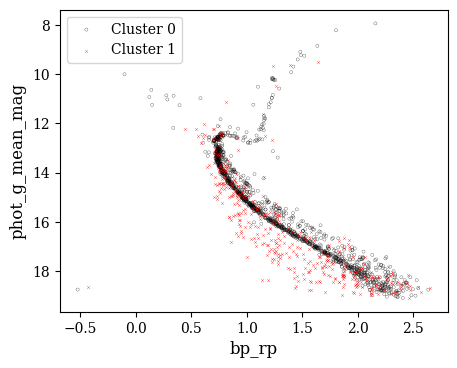

In [33]:
cmd_plotly(df_cluster, 
           'bp_rp', 'phot_g_mean_mag', huex='gmm_pred', s=5, alpha=1, theme={1:'red', 0:'black'})

In [34]:
df_cluster["cluster_pred_num"] = np.where(df_cluster['gmm_pred'] == 1, 0, 
                                                   np.where(df_cluster['gmm_pred'] == 0, 1, 
                                                            df_cluster['gmm_pred']))

In [35]:
num_cluster = 1

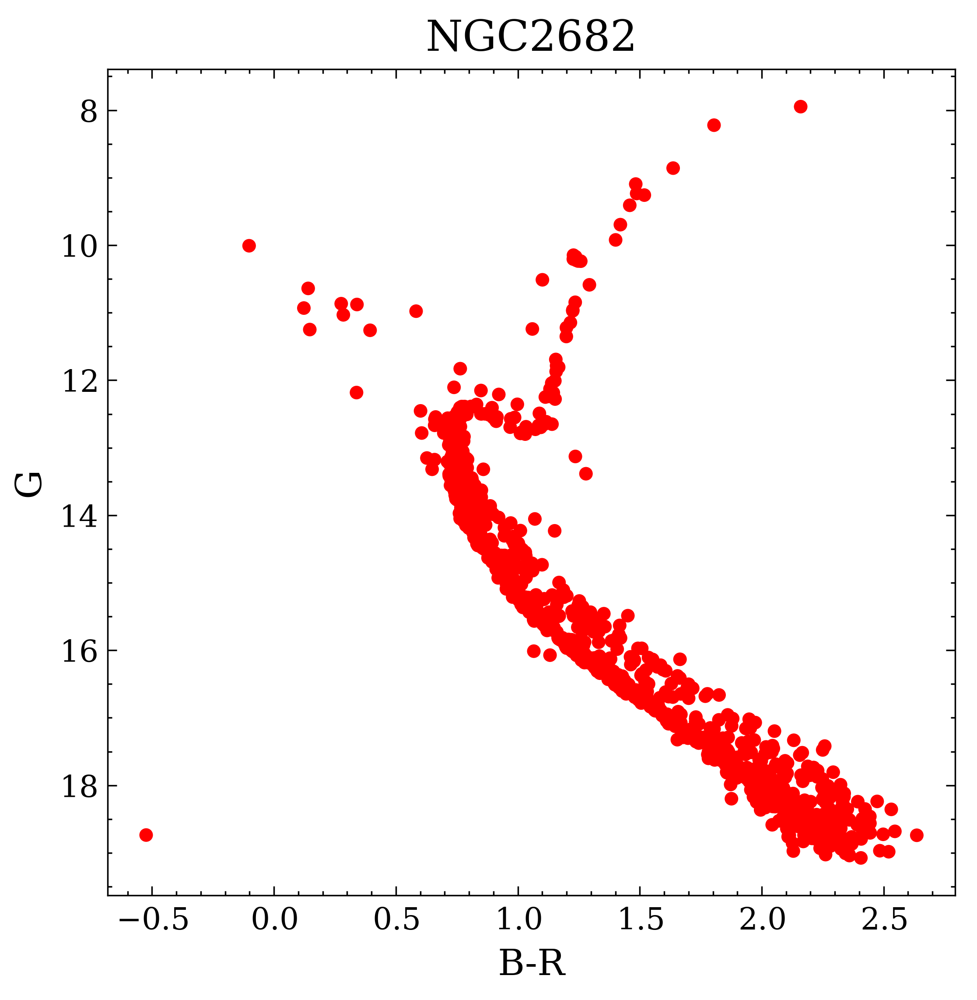

In [36]:
with plt.style.context(['science', 'ieee', 'no-latex']):
    plt.figure(figsize=(5, 5), dpi=500)
    
    sns.scatterplot(
        data=df_cluster[df_cluster['cluster_pred_num'] == num_cluster], 
        x='bp_rp', 
        y='phot_g_mean_mag', 
        s=20, 
        alpha=1, 
        lw=0, 
        edgecolor="none", 
        color="red"
    )
    
    plt.xlabel("B-R", fontsize=12)
    plt.ylabel("G", fontsize=12)
    plt.title(f"{name_title}", fontsize=14)
    plt.gca().invert_yaxis()
    plt.tick_params(axis='both', labelsize=10)
    
    plt.savefig(f"{path}/{cluster_name}_cmd_gmm.pdf")
    plt.savefig(f"{path}/{cluster_name}_cmd_gmm.jpg")

In [37]:
### cluster stars

len(df_cluster[(df_cluster['cluster_pred_num']==num_cluster)])

1284

In [38]:
### high probable stars
len(df_cluster[(df_cluster['cluster_pred_num']==num_cluster) & (df_cluster['gmm_prob']>=0.8)])

1246

In [39]:
new_cluster["gmm_filter"] = len(df_cluster[(df_cluster['cluster_pred_num']==num_cluster)])

In [40]:
new_cluster["prob_80"] = len(df_cluster[(df_cluster['cluster_pred_num']==num_cluster) &
                                                 (df_cluster['gmm_prob']>=0.8)])

# 4. Evaluation

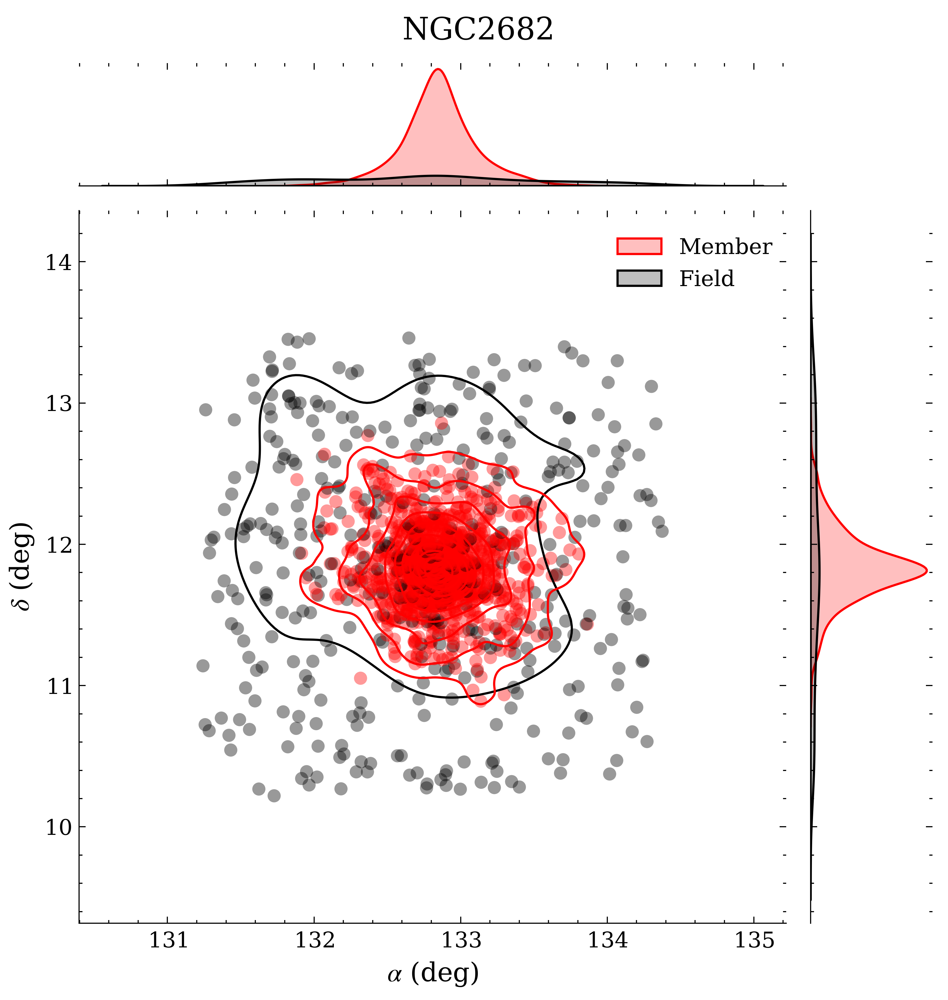

In [41]:
with plt.style.context(['science', 'ieee', 'no-latex']):
    g = sns.jointplot(
        data=df_cluster, 
        x='ra', 
        y='dec', 
        kind='scatter', 
        hue='cluster_pred_num', 
        alpha=0.4, 
        lw=0, 
        edgecolor="none", 
        legend=False
    )
    
    sns.kdeplot(
        data=df_cluster, 
        x='ra', 
        y='dec', 
        hue='cluster_pred_num', 
        alpha=1, 
        ax=g.ax_joint, 
        legend=False
    )
    
    g.ax_joint.set_xlabel(r'$\alpha$ (deg)', fontsize=12)
    g.ax_joint.set_ylabel(r'$\delta$ (deg)', fontsize=12)
    g.ax_joint.tick_params(axis='both', labelsize=10)
    plt.legend(labels=['Member', 'Field'], loc='upper right', bbox_to_anchor=(-0.15, 0.99), fontsize=10)
    plt.suptitle(f"{name_title}", y=1.03, fontsize=14)  
    plt.savefig(f"{path}/{cluster_name}_kde_scatter.pdf")
    plt.savefig(f"{path}/{cluster_name}_kde_scatter.jpg")


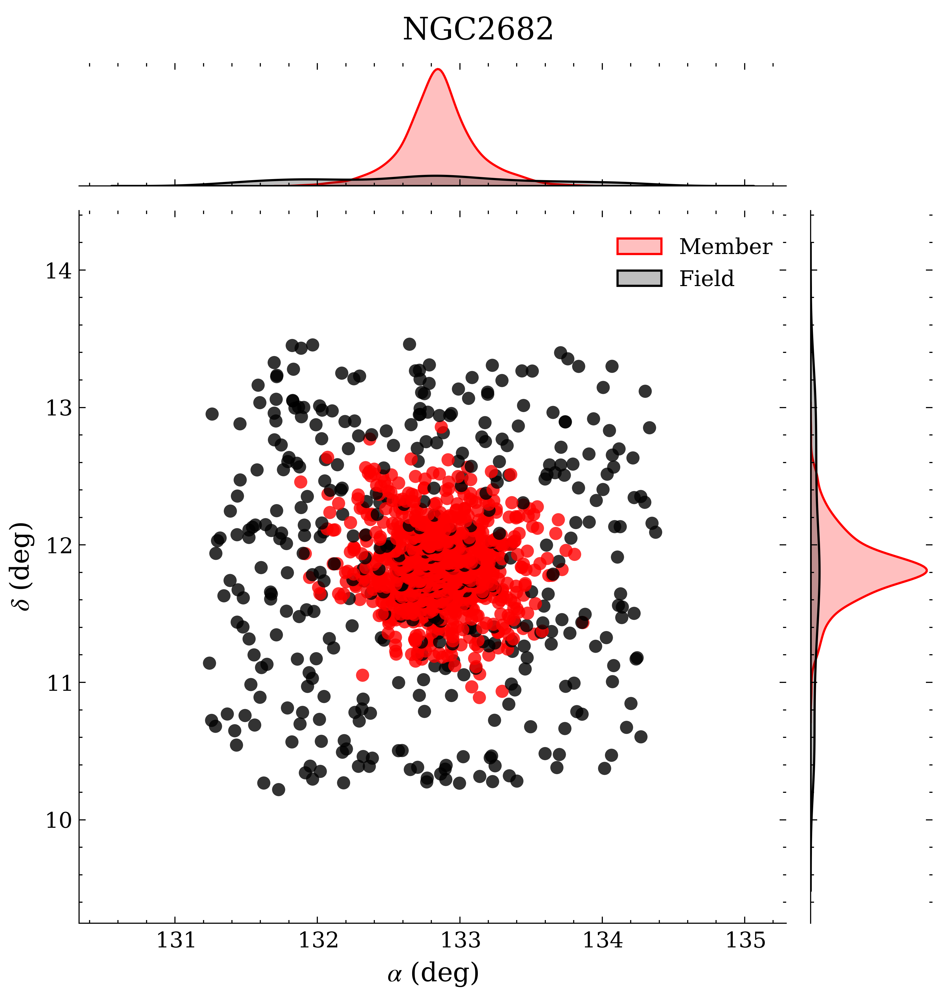

In [42]:
with plt.style.context(['science', 'ieee', 'no-latex']):
    g = sns.jointplot(
        data=df_cluster, 
        x='ra', 
        y='dec', 
        kind='scatter', 
        hue='cluster_pred_num', 
        alpha=0.8, 
        lw=0, 
        edgecolor="none", 
        legend=False
    )
    
    g.ax_joint.set_xlabel(r'$\alpha$ (deg)', fontsize=12)
    g.ax_joint.set_ylabel(r'$\delta$ (deg)', fontsize=12)
    g.ax_joint.tick_params(axis='both', labelsize=10)
    plt.legend(labels=['Member', 'Field'], loc='upper right', bbox_to_anchor=(-0.15, 0.99), fontsize=10)
    plt.suptitle(f"{name_title}", y=1.03, fontsize=14)
    plt.savefig(f"{path}/{cluster_name}_joint_scatter.pdf")
    plt.savefig(f"{path}/{cluster_name}_joint_scatter.jpg")


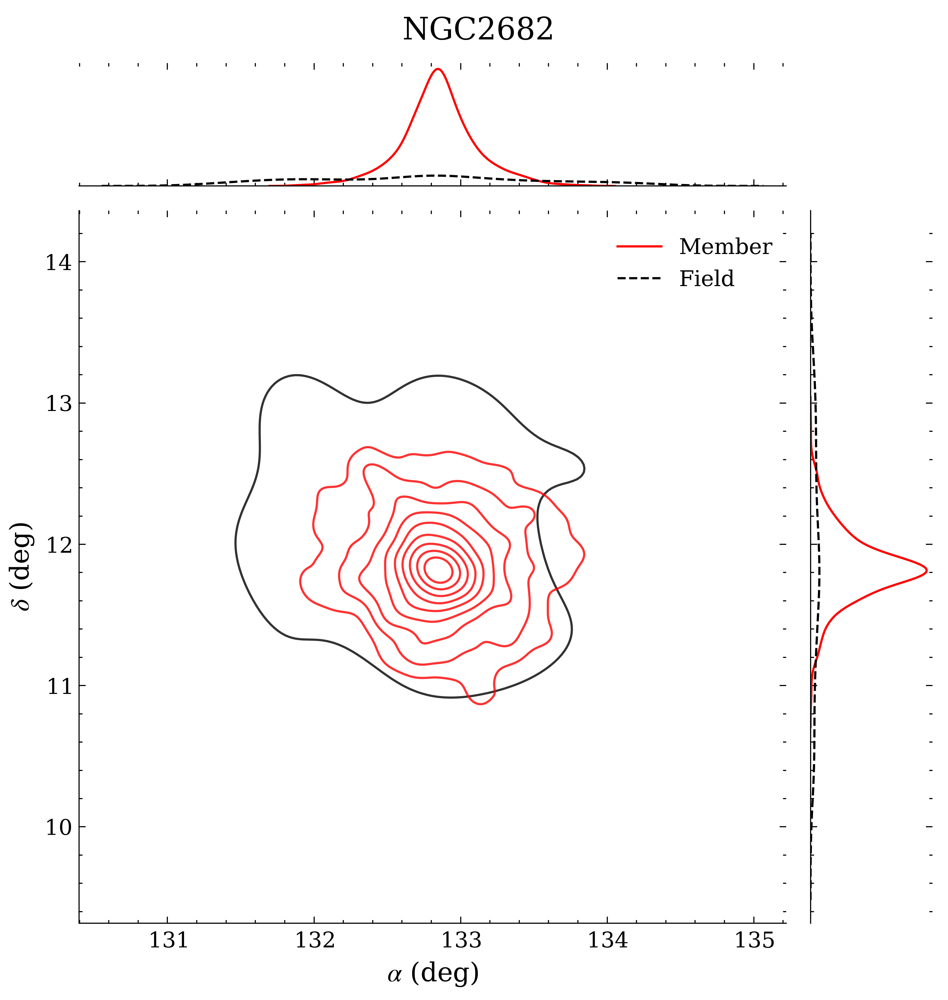

In [43]:
with plt.style.context(['science', 'ieee', 'no-latex']):
    g = sns.jointplot(
        data=df_cluster, 
        x='ra', 
        y='dec', 
        kind='kde', 
        hue='cluster_pred_num', 
        alpha=0.8, 
        lw=0, 
        edgecolor="none", 
        legend=False
    )
    
    g.ax_joint.set_xlabel(r'$\alpha$ (deg)', fontsize=12)
    g.ax_joint.set_ylabel(r'$\delta$ (deg)', fontsize=12)
    g.ax_joint.tick_params(axis='both', labelsize=10)
    plt.legend(labels=['Member', 'Field'], loc='upper right', bbox_to_anchor=(-0.15, 0.99), fontsize=10)
    plt.suptitle(f"{name_title}", y=1.03, fontsize=14)
    plt.savefig(f"{path}/{cluster_name}_kde.pdf")
    plt.savefig(f"{path}/{cluster_name}_kde.jpg")

In [44]:
def black_body_plot(data, x_axis, y_axis, ax=None, alpha=0.8, s=8, 
                    x_label='Color Index', y_label='Color Index'):
    """Create standardized black body plots with consistent font styling"""
    with plt.style.context(['ieee']):
        if ax is None:
            fig = plt.figure(figsize=(4,4), dpi=100)
            ax = fig.add_subplot(111)
        
        # Create the scatter plot
        sns.scatterplot(
            data=data,
            y=y_axis,
            x=x_axis,
            alpha=alpha,
            s=s,
            ax=ax,
            color='black',
            lw=0,
            edgecolor="none"
        )
        
        # Apply consistent formatting
        ax.set_xlabel(x_label, fontsize=12)
        ax.set_ylabel(y_label, fontsize=12)
        ax.tick_params(axis='both', labelsize=10)
        ax.invert_xaxis()

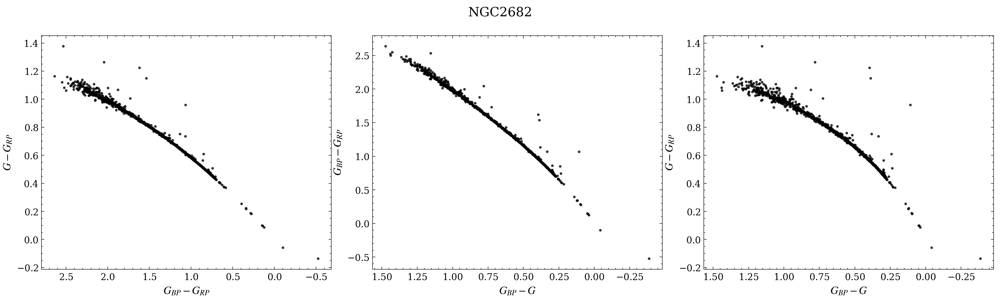

In [45]:
with plt.style.context(['science', 'ieee', 'no-latex']):
    # Create figure with 3 subplots
    fig, axes = plt.subplots(1, 3, figsize=(15,4), dpi=300, constrained_layout=True)
    
    # Plot data using the standardized function
    black_body_plot(
        df_cluster[df_cluster['cluster_pred_num'] == num_cluster], 
        'bp_rp', 'g_rp', ax=axes[0],
        x_label=r'$G_{BP}-G_{RP}$', y_label=r'$G-G_{RP}$'
    )
    black_body_plot(
        df_cluster[df_cluster['cluster_pred_num'] == num_cluster],
        'bp_g', 'bp_rp', ax=axes[1],
        x_label=r'$G_{BP}-G$', y_label=r'$G_{BP}-G_{RP}$'
    )
    black_body_plot(
        df_cluster[df_cluster['cluster_pred_num'] == num_cluster],
        'bp_g', 'g_rp', ax=axes[2],
        x_label=r'$G_{BP}-G$', y_label=r'$G-G_{RP}$'
    )
    
    # Add figure title and save
    plt.suptitle(f"{name_title}", y=1.1, fontsize=14)
    plt.savefig(f"{path}/{cluster_name}_bb.pdf")
    plt.savefig(f"{path}/{cluster_name}_bb.png", transparent=True)


### King Profile

In [46]:
cluster = df_cluster[(df_cluster['cluster_pred_num']==num_cluster)]

In [47]:
new_cluster["ra"], new_cluster["dec"], new_cluster["pmra"], new_cluster["pmdec"], new_cluster["plx"]  = \
np.mean(cluster['ra']), np.mean(cluster['dec']), np.mean(cluster['pmra']), np.mean(cluster['pmdec']), np.mean(cluster['parallax'])

In [48]:
# galactic_coord = SkyCoord(l=101.12151 * u.deg, b=-21.156262 * u.deg, frame='galactic')

# icrs_coord = galactic_coord.transform_to('icrs')

# print("RA (ICRS J2000):", icrs_coord.ra.to_string(u.hour))
# print("Dec (ICRS J2000):", icrs_coord.dec.to_string(u.degree))

In [49]:
np.mean(cluster['ra']), np.mean(cluster['dec'])

(132.8502960412102, 11.835722856469081)

In [50]:
# Fit the King profile
coefs, R_t, cov = fit_king_profile(cluster, path=path, radius_num=43, cluster_name=cluster_name)

f_b, f_0, R_c = coefs[0], coefs[1], coefs[2]


# Print results
print(name_title)
print("f_b:", round(f_b, 2), 'std:', round(np.sqrt(cov[0, 0]), 2))  # Background density and its error
print("f_0:", round(f_0, 2))  # Central density above the background
print("R_c:", round(R_c, 2))  # Core radius
print("R_t:", round(R_t, 2))  # Tidal radius

NGC2682
f_b: 46.25 std: 64.14
f_0: 12054.17
R_c: 0.07
R_t: 0.58


In [51]:
# Core radius error
err_Rc = np.sqrt(cov[2, 2])  # Standard deviation of R_c
print("Err Rc:", round(err_Rc, 5))

# Tidal radius error calculation
err_Rt = (coefs[2] + err_Rc) * np.sqrt(coefs[1] / (3 * np.sqrt(cov[0, 0])) - 1)
print("Err Rt:", round(err_Rt, 5))

Err Rc: 0.00291
Err Rt: 0.60776


In [52]:
# Center of the cluster
center = (np.mean(cluster['ra']), np.mean(cluster['dec']))
distances = np.sqrt((cluster['ra'] - center[0])**2 + (cluster['dec'] - center[1])**2)

# Stars within core radius
stars_within_core = cluster[(distances < coefs[2])]
print(f"Stars within core radius: {len(stars_within_core)}")

# Stars outside tidal radius
stars_out_of_bound = cluster[(distances > R_t)]
print(f"Stars outside tidal radius: {len(stars_out_of_bound)}")

Stars within core radius: 168
Stars outside tidal radius: 157


In [53]:
new_cluster["fb"] = f_b
new_cluster["f0"] = f_0
new_cluster["Rc"] = R_c
new_cluster["Rt"] = R_t
new_cluster["fb_error"] = np.sqrt(cov[0, 0])
new_cluster["f0_error"] = np.sqrt(cov[1, 1])
new_cluster["Rc_error"] = np.sqrt(cov[2, 2])
new_cluster["Rt_error"] = err_Rt

In [54]:
new_cluster

{'Name': 'NGC_2682',
 'init_data': 31288,
 'init_filter': 2279,
 'mst_cut': 0.69,
 'mst_filter': 1826,
 'gmm_filter': 1284,
 'prob_80': 1246,
 'ra': 132.8502960412102,
 'dec': 11.835722856469081,
 'pmra': -10.962379540318645,
 'pmdec': -2.909125803511809,
 'plx': 1.1547620304231334,
 'ra_error': 0,
 'dec_error': 0,
 'pmra_error': 0,
 'pmdec_error': 0,
 'plx_error': 0,
 'fb': 46.251578105225285,
 'f0': 12054.173365107708,
 'Rc': 0.07449564473154756,
 'Rt': 0.5848875447200895,
 'fb_error': 64.14228166415626,
 'f0_error': 270.47035873378184,
 'Rc_error': 0.0029137804567091843,
 'Rt_error': 0.6077645048876188}

In [55]:
# df_cluster = df_cluster.merge(
#     df[["SOURCE_ID", "r_med_geo"]], on='source_id', how='left').drop("index", axis=1)

### Final Plots

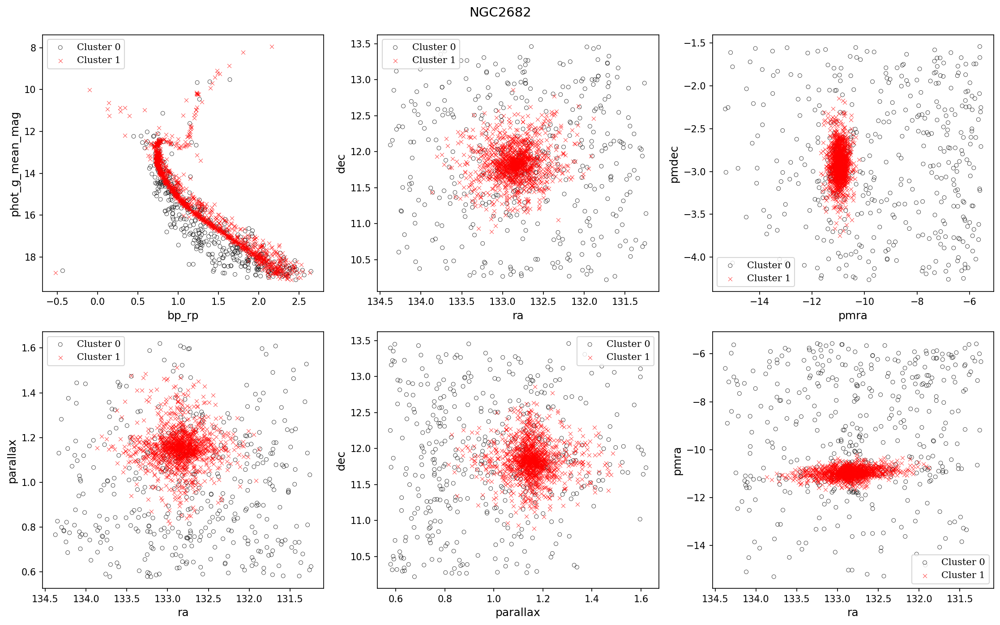

In [56]:
### PLOT THE CLUSTERS

fig, axes = plt.subplots(2, 3, figsize=(15, 9), dpi=150)

cmd_plotly(df_cluster, 'bp_rp', 'phot_g_mean_mag', huex='cluster_pred_num', s=18, alpha=1, ax=axes[0, 0], theme={1: 'red', 0: 'black'})
cmd_plotly(df_cluster, 'ra', 'dec', huex='cluster_pred_num', s=18, alpha=1, ax=axes[0, 1], theme={1: 'red', 0: 'black'}, invert_yaxis=False)
axes[0, 1].invert_xaxis()
cmd_plotly(df_cluster, 'ra', 'parallax', huex='cluster_pred_num', s=18, alpha=1, ax=axes[1, 0], theme={1: 'red', 0: 'black'}, invert_yaxis=False)
axes[1, 0].invert_xaxis()
cmd_plotly(df_cluster, 'parallax', 'dec', huex='cluster_pred_num', s=18, alpha=1, ax=axes[1, 1], theme={1: 'red', 0: 'black'}, invert_yaxis=False)
cmd_plotly(df_cluster, 'pmra', 'pmdec', huex='cluster_pred_num', s=18, alpha=1, ax=axes[0, 2], theme={1: 'red', 0: 'black'}, invert_yaxis=False)
cmd_plotly(df_cluster, 'ra', 'pmra', huex='cluster_pred_num', s=18, alpha=1, ax=axes[1, 2], theme={1: 'red', 0: 'black'}, invert_yaxis=False)
axes[1, 2].invert_xaxis()

# Add consistent font styling
for ax in axes.flat:
    ax.set_xlabel(ax.get_xlabel(), fontsize=12)  # Set x-axis label font size
    ax.set_ylabel(ax.get_ylabel(), fontsize=12)  # Set y-axis label font size
    ax.tick_params(axis='both', labelsize=10)    # Adjust tick label font size

plt.tight_layout()
plt.suptitle(f"{name_title}", fontsize=14, y=1.03)  # Add title with custom font size
plt.show()


In [57]:
len(cluster[cluster["gmm_prob"]>=0.99])

1040

In [58]:
len(cluster[cluster["gmm_prob"]>=0.8])

1246

In [59]:
len(cluster[cluster["gmm_prob"]>=0.6])

1271

In [60]:
len(cluster)

1284

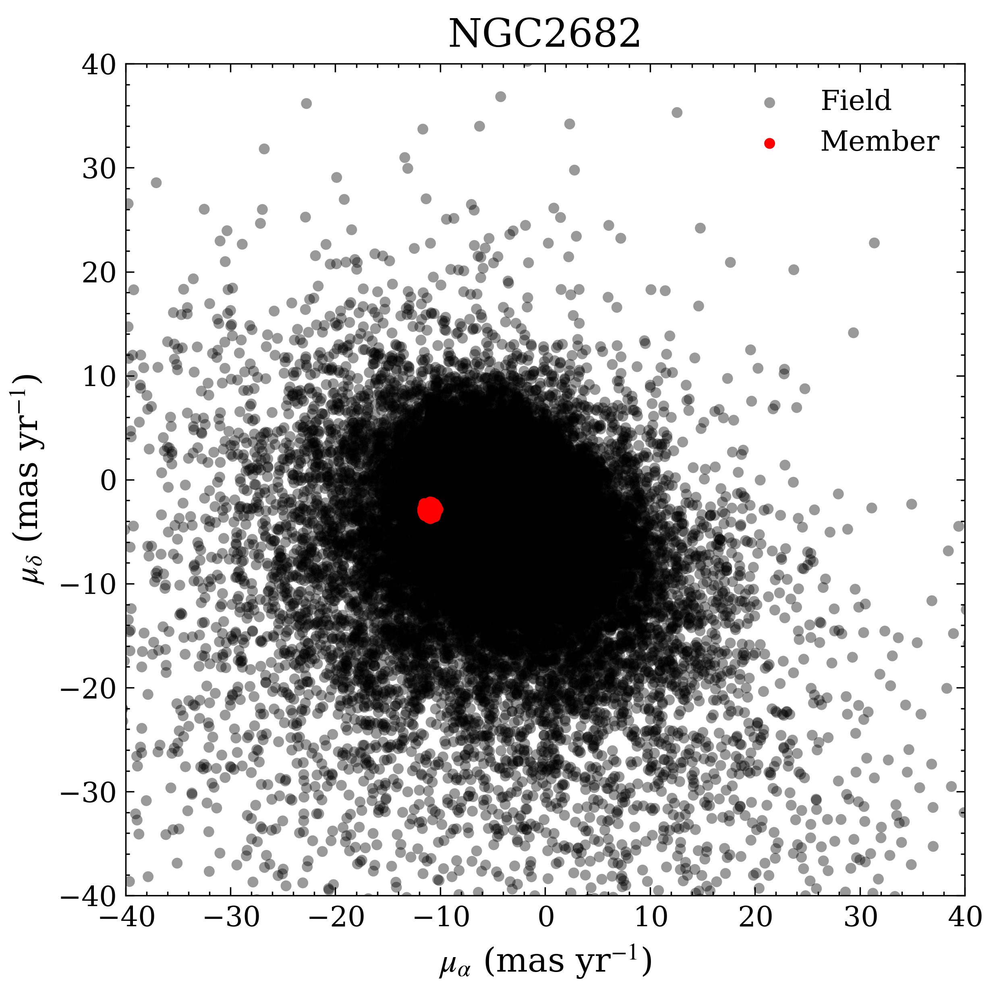

In [61]:
with plt.style.context(['science', 'ieee', 'no-latex']):
    plt.figure(figsize=(5, 5), dpi=500)
    sns.scatterplot(data=df, 
                    x='pmra', y='pmdec', s=15, alpha=0.4, color="black", label="Field", lw=0, edgecolor="none")
    sns.scatterplot(data=df_cluster[df_cluster['cluster_pred_num'] == num_cluster],
                    x='pmra', y='pmdec', s=15, alpha=1, color='red', label="Member", lw=0, edgecolor="none")
    
    plt.xlabel(r'$\mu_\alpha$ (mas yr$^{-1}$)', fontsize=12)  
    plt.ylabel(r'$\mu_\delta$ (mas yr$^{-1}$)', fontsize=12)  
    plt.xlim(-40, 40)
    plt.ylim(-40, 40)
    plt.legend(fontsize=10)  
    plt.title(f"{name_title}", fontsize=14)  
    plt.tick_params(axis='both', which='major', labelsize=10)  
    plt.tight_layout()  
    plt.savefig(path + f"/{cluster_name}_field_motion.jpg")

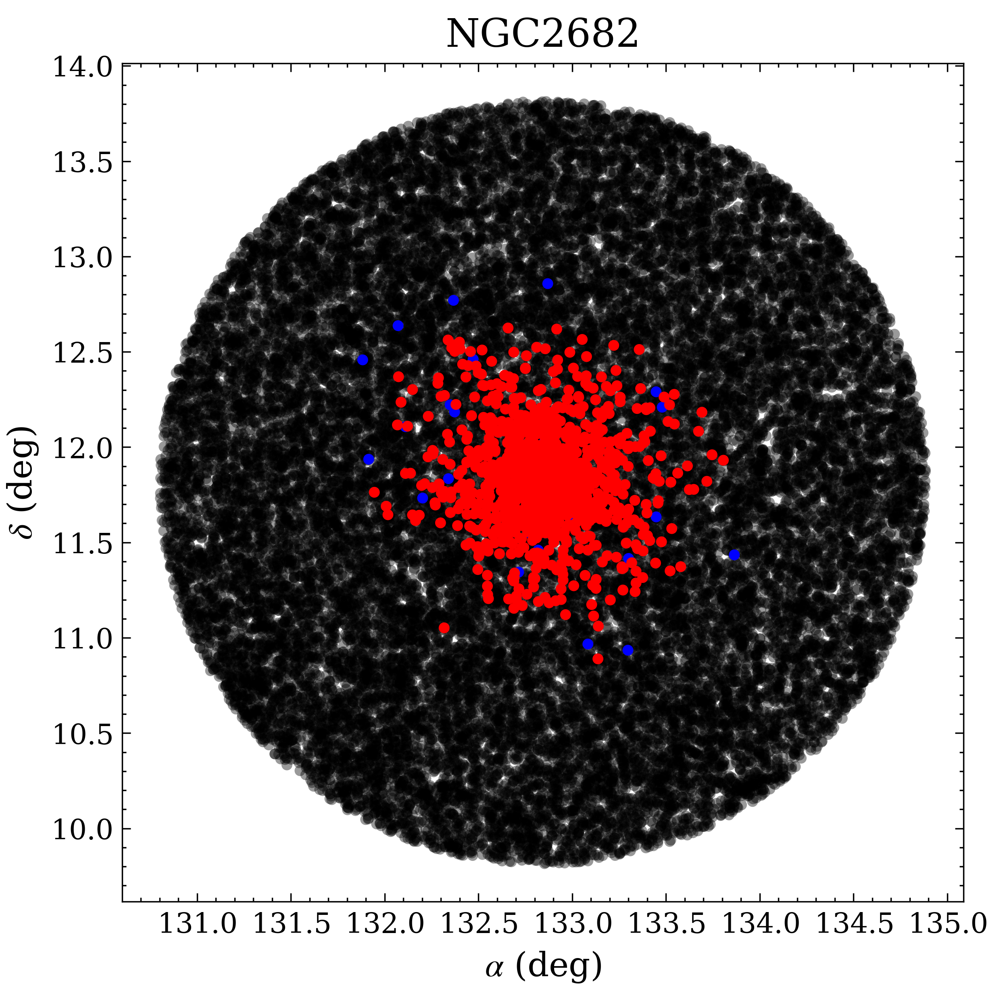

In [62]:
with plt.style.context(['science', 'ieee', 'no-latex']):
    plt.figure(figsize=(5, 5), dpi=500)
    
    # Plot field stars (data outside the cluster)
    sns.scatterplot(data=df, 
                    x='ra', y='dec', s=15, alpha=0.4, color="black", lw=0, edgecolor="none")
    
    # Filter data for 0.5 < gmm_prob <= 0.8 (blue dots)
    sns.scatterplot(data=df_cluster[
        (df_cluster['cluster_pred_num'] == num_cluster) & 
        (df_cluster['gmm_prob'] > 0.5) & 
        (df_cluster['gmm_prob'] <= 0.8)],
        x='ra', y='dec', s=15, alpha=1, color='blue', lw=0, edgecolor="none")

    # Filter data for gmm_prob > 0.8 (red dots)
    sns.scatterplot(data=df_cluster[
        (df_cluster['cluster_pred_num'] == num_cluster) & 
        (df_cluster['gmm_prob'] > 0.8)],
        x='ra', y='dec', s=15, alpha=1, color='red', lw=0, edgecolor="none")

    # Formatting and labels
    plt.ylabel(r'$\delta$ (deg)', fontsize=12)  
    plt.xlabel(r'$\alpha$ (deg)', fontsize=12)  
    plt.title(f"{name_title}", fontsize=14)  
    plt.tick_params(axis='both', which='major', labelsize=10)  
    plt.tight_layout()  
    plt.savefig(path + f"/{cluster_name}_field_position.jpg")

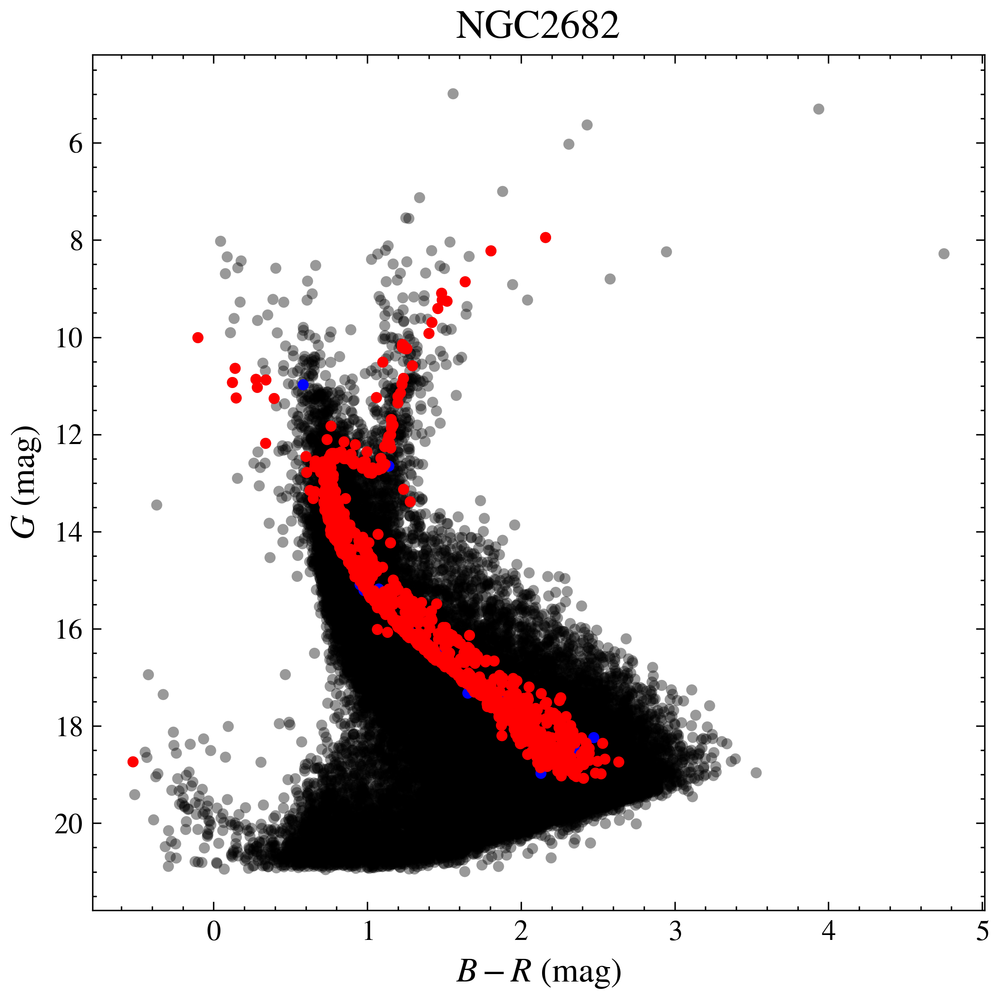

In [63]:
with plt.style.context(['science', 'ieee', 'no-latex']):
    plt.figure(figsize=(5, 5), dpi=500)
    sns.scatterplot(data=df, x='bp_rp', y='phot_g_mean_mag', s=15, alpha=0.4, 
                    color="black", lw=0, edgecolor="none")
    sns.scatterplot(data=df_cluster[
        (df_cluster['cluster_pred_num'] == num_cluster) & 
        (df_cluster['gmm_prob'] > 0.5) & 
        (df_cluster['gmm_prob'] <= 0.8)],
        x='bp_rp', y='phot_g_mean_mag', s=15, alpha=1, color='blue', lw=0, edgecolor="none")
    sns.scatterplot(data=df_cluster[
        (df_cluster['cluster_pred_num'] == num_cluster) & 
        (df_cluster['gmm_prob'] > 0.8)],
        x='bp_rp', y='phot_g_mean_mag', s=15, alpha=1, color='red', lw=0, edgecolor="none")
    plt.gca().invert_yaxis()
    plt.ylabel(r'$G$ (mag)', fontsize=12)  # Font size for y-axis label
    plt.xlabel(r'$B-R$ (mag)', fontsize=12)  # Font size for x-axis label
    plt.title(f"{name_title}", fontsize=14)  # Font size for title
    plt.tick_params(axis='both', which='major', labelsize=10)  # Font size for tick labels
    plt.tight_layout()  # Adjust layout to avoid overlaps
    plt.savefig(path + f"/{cluster_name}_field_CMD.jpg")
    plt.show()

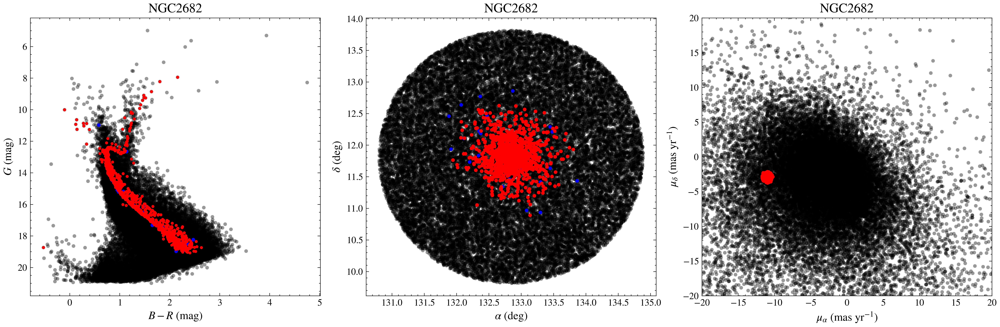

In [64]:
with plt.style.context(['science', 'ieee', 'no-latex']):

    # Create a figure with 1 row and 3 columns
    fig, axes = plt.subplots(1, 3, figsize=(15, 5), dpi=500)

    # First subplot: CMD (bp_rp vs phot_g_mean_mag)
    sns.scatterplot(data=df, x='bp_rp', y='phot_g_mean_mag', s=15, alpha=0.4, 
                    color="black", ax=axes[0], lw=0, edgecolor="none")
    sns.scatterplot(data=df_cluster[
        (df_cluster['cluster_pred_num'] == num_cluster) & 
        (df_cluster['gmm_prob'] > 0.5) & 
        (df_cluster['gmm_prob'] <= 0.8)],
        x='bp_rp', y='phot_g_mean_mag', s=15, alpha=1, color='blue', ax=axes[0], lw=0, edgecolor="none")
    sns.scatterplot(data=df_cluster[
        (df_cluster['cluster_pred_num'] == num_cluster) & 
        (df_cluster['gmm_prob'] > 0.8)],
        x='bp_rp', y='phot_g_mean_mag', s=10, alpha=1, color='red', ax=axes[0], lw=0, edgecolor="none")
    axes[0].invert_yaxis()
    axes[0].set_ylabel(r'$G$ (mag)', fontsize=12)  # Set y-axis font size
    axes[0].set_xlabel(r'$B-R$ (mag)', fontsize=12)  # Set x-axis font size
    axes[0].set_title(f"{name_title}", fontsize=14)  # Set title font size
    axes[0].tick_params(axis='both', labelsize=10)  # Adjust tick font size

    # Second subplot: ra vs dec
    sns.scatterplot(data=df, x='ra', y='dec', s=15, alpha=0.4, 
                    color="black", ax=axes[1], lw=0, edgecolor="none")
    sns.scatterplot(data=df_cluster[
        (df_cluster['cluster_pred_num'] == num_cluster) & 
        (df_cluster['gmm_prob'] > 0.5) & 
        (df_cluster['gmm_prob'] <= 0.8)],
        x='ra', y='dec', s=15, alpha=1, color='blue', ax=axes[1], lw=0, edgecolor="none")
    sns.scatterplot(data=df_cluster[
        (df_cluster['cluster_pred_num'] == num_cluster) & 
        (df_cluster['gmm_prob'] > 0.8)],
        x='ra', y='dec', s=15, alpha=1, color='red', ax=axes[1], lw=0, edgecolor="none")
    axes[1].set_ylabel(r'$\delta$ (deg)', fontsize=12)  # Set y-axis font size
    axes[1].set_xlabel(r'$\alpha$ (deg)', fontsize=12)  # Set x-axis font size
    axes[1].set_title(f"{name_title}", fontsize=14)  # Set title font size
    axes[1].tick_params(axis='both', labelsize=10)  # Adjust tick font size

    # Third subplot: pmra vs pmdec
    sns.scatterplot(data=df, 
                    x='pmra', y='pmdec', s=15, alpha=0.4, color="black", ax=axes[2], lw=0, edgecolor="none")
    sns.scatterplot(data=df_cluster[
        (df_cluster['cluster_pred_num'] == num_cluster)],
        x='pmra', y='pmdec', s=15, alpha=1, color='red', ax=axes[2], lw=0, edgecolor="none")
    axes[2].set_xlim(-20, 20)
    axes[2].set_ylim(-20, 20)
    axes[2].set_ylabel(r'$\mu_\delta$ (mas yr$^{-1}$)', fontsize=12)  # Set y-axis font size
    axes[2].set_xlabel(r'$\mu_\alpha$ (mas yr$^{-1}$)', fontsize=12)  # Set x-axis font size
    axes[2].set_title(f"{name_title}", fontsize=14)  # Set title font size
    axes[2].tick_params(axis='both', labelsize=10)  # Adjust tick font size

    # Adjust layout to prevent overlap
    plt.tight_layout()
    # plt.savefig(path + "/{cluster_name}_field.pdf")
    plt.savefig(path + f"/{cluster_name}_field.jpg")
    plt.show()

---

### Mass Segregation

In [65]:
cluster['M_G'] = cluster['phot_g_mean_mag'] - 5 * np.log10(1000.0 / cluster['parallax']) + 5

In [66]:
df_cluster['M_G'] = df_cluster['phot_g_mean_mag'] - 5 * np.log10(1000.0 / df_cluster['parallax']) + 5

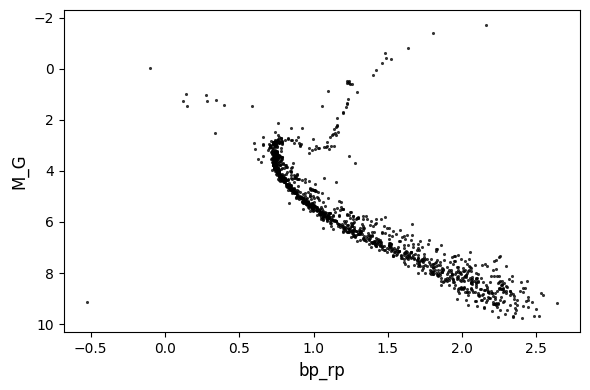

In [67]:
cmd_plot(data=cluster, x_axis="bp_rp", y_axis="M_G")

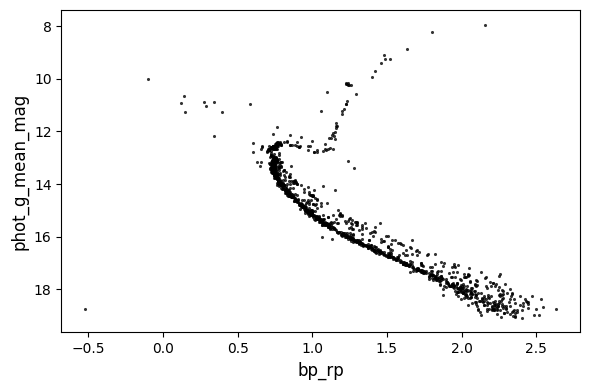

In [68]:
cmd_plot(data=cluster, x_axis="bp_rp", y_axis="phot_g_mean_mag")

In [69]:
def assign_mass_groups(df, mg_col='M_G'):
    """
    Divide the stars into three groups (high, mid, low mass) based on the percentiles of M_G.
    Lower M_G corresponds to brighter and (roughly) higher mass.
    
    The groups are defined as:
      - High Mass: M_G < 33rd percentile (brightest/highest mass)
      - Mid Mass : 33rd percentile <= M_G < 66th percentile
      - Low Mass : M_G >= 66th percentile (faintest/lowest mass)
    """
    # Compute the critical percentiles (33% and 66% quantiles)
    perc33 = df[mg_col].quantile(0.33)
    perc66 = df[mg_col].quantile(0.66)
    
    # Define mass groups based on M_G
    conditions = [
        df[mg_col] < perc33,
        (df[mg_col] >= perc33) & (df[mg_col] < perc66),
        df[mg_col] >= perc66
    ]
    choices = ['High Mass', 'Mid Mass', 'Low Mass']
    
    df = df.copy()
    df['mass_group'] = np.select(conditions, choices, default='Undefined')
    
    return df, perc33, perc66

def compute_radial_distance(df, center_ra, center_dec, ra_col='ra', dec_col='dec'):
    """
    Compute the radial (Euclidean) distance from each star to the cluster center in RA/Dec space.
    Assumes input coordinates are already in degrees.
    """
    df = df.copy()
    df['radial_distance'] = np.sqrt((df[ra_col] - center_ra)**2 + (df[dec_col] - center_dec)**2)
    return df

In [70]:
cluster, perc33, perc66 = assign_mass_groups(cluster, mg_col='M_G')
print(f"33% of M_G: {perc33:.2f}, \n66% of M_G: {perc66:.2f}")

33% of M_G: 4.60, 
66% of M_G: 6.79


In [71]:
cluster = compute_radial_distance(cluster, cluster["ra"].mean(), cluster["dec"].mean(), ra_col='ra', dec_col='dec')

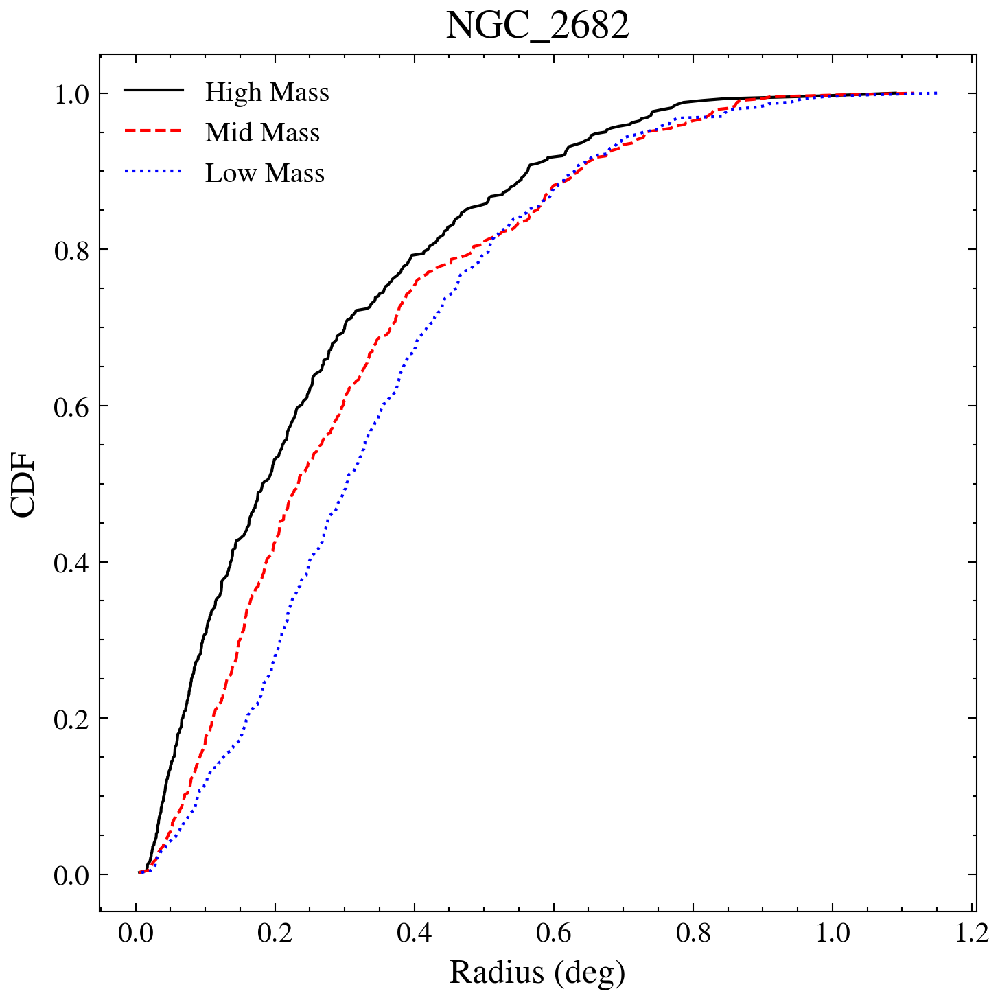

In [72]:
with plt.style.context(['science', 'ieee', 'no-latex']):
        plt.figure(figsize=(5, 5), dpi=300)
        for group in ['High Mass', 'Mid Mass', 'Low Mass']:
            subset = cluster[cluster["mass_group"] == group]["radial_distance"].sort_values().values
            cdf = np.arange(1, len(subset)+1) / len(subset)
            plt.plot(subset, cdf, label=group)
        plt.xlabel("Radius (deg)", fontsize=12)
        plt.ylabel("CDF", fontsize=12)
        plt.title(cluster_name, fontsize=14)
        plt.legend(fontsize=10)
        plt.tick_params(axis='both', which='major', labelsize=10)
        # plt.grid(True)
        plt.tight_layout()
        plt.savefig(path + f"/{cluster_name}_mass_seg.jpg")
        plt.savefig(path + f"/{cluster_name}_mass_seg.pdf")
        plt.show()

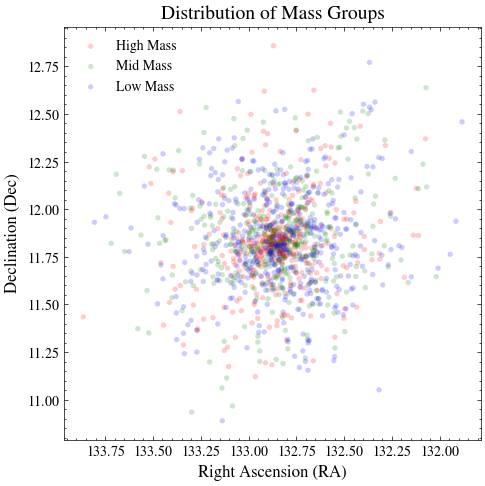

In [73]:
with plt.style.context(['science', 'ieee', 'no-latex']):
        plt.figure(figsize=(5, 5), dpi=100)
        
        # Define a color mapping for mass groups
        color_map = {'High Mass': 'red', 'Mid Mass': 'green', 'Low Mass': 'blue'}
        
        for group, color in color_map.items():
            subset = cluster[cluster["mass_group"] == group]
            plt.scatter(subset["ra"], subset["dec"], 
                        label=group, color=color, s=15, alpha=0.2, edgecolor='none')
        
        plt.xlabel("Right Ascension (RA)", fontsize=12)
        plt.ylabel("Declination (Dec)", fontsize=12)
        plt.title("Distribution of Mass Groups", fontsize=14)
        plt.legend(fontsize=10)
        plt.tick_params(axis='both', which='major', labelsize=10)
        plt.tight_layout()
        plt.gca().invert_xaxis() # Invert RA axis to match astronomical convention
        plt.show()

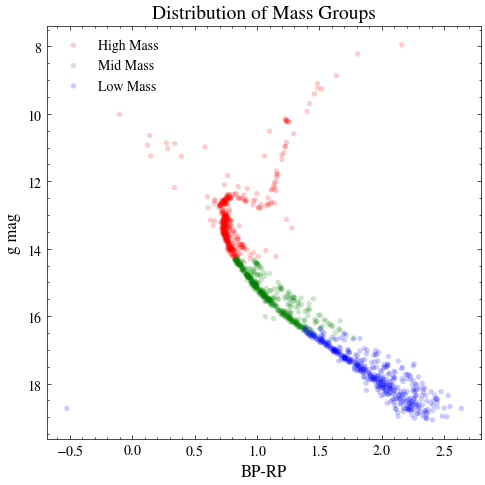

In [74]:
with plt.style.context(['science', 'ieee', 'no-latex']):
        plt.figure(figsize=(5, 5), dpi=100)
        
        # Define a color mapping for mass groups
        color_map = {'High Mass': 'red', 'Mid Mass': 'green', 'Low Mass': 'blue'}
        
        for group, color in color_map.items():
            subset = cluster[cluster["mass_group"] == group]
            plt.scatter(subset["bp_rp"], subset["phot_g_mean_mag"], 
                        label=group, color=color, s=15, alpha=0.2, edgecolor='none')
        
        plt.xlabel("BP-RP", fontsize=12)
        plt.ylabel("g mag", fontsize=12)
        plt.title("Distribution of Mass Groups", fontsize=14)
        plt.legend(fontsize=10)
        plt.tick_params(axis='both', which='major', labelsize=10)
        plt.tight_layout()
        plt.gca().invert_yaxis() # Invert RA axis to match astronomical convention
        plt.show()

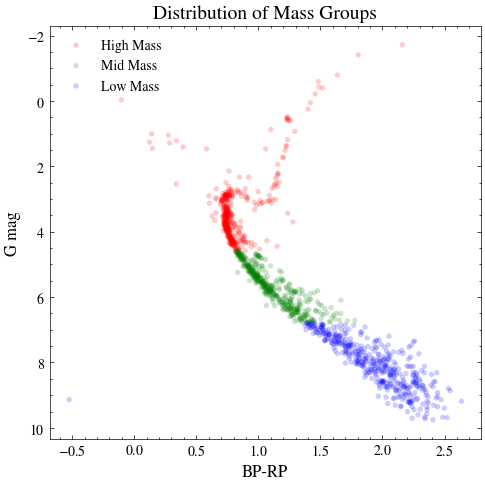

In [75]:
with plt.style.context(['science', 'ieee', 'no-latex']):
        plt.figure(figsize=(5, 5), dpi=100)
        
        # Define a color mapping for mass groups
        color_map = {'High Mass': 'red', 'Mid Mass': 'green', 'Low Mass': 'blue'}
        
        for group, color in color_map.items():
            subset = cluster[cluster["mass_group"] == group]
            plt.scatter(subset["bp_rp"], subset["M_G"], 
                        label=group, color=color, s=15, alpha=0.2, edgecolor='none')
        
        plt.xlabel("BP-RP", fontsize=12)
        plt.ylabel("G mag", fontsize=12)
        plt.title("Distribution of Mass Groups", fontsize=14)
        plt.legend(fontsize=10)
        plt.tick_params(axis='both', which='major', labelsize=10)
        plt.tight_layout()
        plt.gca().invert_yaxis() # Invert RA axis to match astronomical convention
        plt.show()

----------

# Savings

In [76]:
df_cluster = df_cluster.merge(
    df[["SOURCE_ID", "ra_error",
             "dec_error", "pmra_error",
             "pmdec_error", "teff_gspphot"]], on='SOURCE_ID', how='left')

In [77]:
new_cluster["ra_error"], new_cluster["dec_error"], new_cluster["pmra_error"], new_cluster["pmdec_error"], new_cluster["plx_error"] = \
np.mean(df_cluster["ra_error"]), np.mean(df_cluster["dec_error"]), np.mean(df_cluster["pmra_error"]), np.mean(df_cluster["pmdec_error"]), np.mean(df_cluster["parallax_error"])

In [78]:
new_cluster

{'Name': 'NGC_2682',
 'init_data': 31288,
 'init_filter': 2279,
 'mst_cut': 0.69,
 'mst_filter': 1826,
 'gmm_filter': 1284,
 'prob_80': 1246,
 'ra': 132.8502960412102,
 'dec': 11.835722856469081,
 'pmra': -10.962379540318645,
 'pmdec': -2.909125803511809,
 'plx': 1.1547620304231334,
 'ra_error': 0.058950093,
 'dec_error': 0.032205153,
 'pmra_error': 0.07499374,
 'pmdec_error': 0.055215515,
 'plx_error': 0.07155696,
 'fb': 46.251578105225285,
 'f0': 12054.173365107708,
 'Rc': 0.07449564473154756,
 'Rt': 0.5848875447200895,
 'fb_error': 64.14228166415626,
 'f0_error': 270.47035873378184,
 'Rc_error': 0.0029137804567091843,
 'Rt_error': 0.6077645048876188}

In [79]:
desired_cols = ['init_data', 'init_filter', 'mst_cut', 'mst_filter', 'gmm_filter', 'prob_80',
                'ra', 'dec', 'pmra', 'pmdec', 'plx',
                'ra_error', 'dec_error', 'pmra_error', 'pmdec_error', 'plx_error',
                'fb', 'f0', 'Rc', 'Rt',
                'fb_error', 'f0_error', 'Rc_error', 'Rt_error']

In [80]:
if cluster_name in Clusters['Name'].values:
    Clusters.loc[Clusters['Name'] == cluster_name, desired_cols] = [new_cluster[col] for col in desired_cols]
else:
    new_row = pd.DataFrame([{'Name': cluster_name, **{col: new_cluster[col] for col in desired_cols}}])
    Clusters = pd.concat([Clusters, new_row], ignore_index=True)

In [81]:
Clusters.to_excel("../Clusters.xlsx")

PermissionError: [Errno 13] Permission denied: '../Clusters.xlsx'

In [ ]:
df_cluster.to_excel(f"../MST PAPER DATA/{cluster_name}/{cluster_name}_members.xlsx")

### Comparison

In [ ]:
# plots for comparision
tabel = parse_single_table(f"{cluster_name}/{cluster_name}_CG.vot")
df_CG = tabel.to_table().to_pandas()
tabel2 = parse_single_table(f"{cluster_name}/{cluster_name}_Hunt.vot")
df_Hunt = tabel2.to_table().to_pandas()

In [ ]:
len(df_Hunt)

In [ ]:
df_hunt_50 = df_Hunt[df_Hunt["Prob"]>0.5]
len(df_hunt_50)

In [ ]:
gmm_pred = num_cluster

with plt.style.context(['science', 'ieee', 'no-latex']):

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6), dpi=300)

    print(f"CG members = {len(df_CG)}\n \
    Hunt members = {len(df_hunt_50)}\n \
    MST members = {len(df_cluster[df_cluster['cluster_pred_num']==gmm_pred])}")

    # First scatter plot: CG vs MST
    ax1.scatter(df_CG['BP-RP'], df_CG['Gmag'], label='CG', 
                marker="o", edgecolor="red", facecolor="none", lw=1)
    ax1.scatter(df_cluster[df_cluster['cluster_pred_num'] == gmm_pred]['bp_rp'], 
                df_cluster[df_cluster['cluster_pred_num'] == gmm_pred]['phot_g_mean_mag'], 
                label='MST', c='k', alpha=0.99, marker='x')
    ax1.set_title("CG vs MST", fontsize=14)  # Font size for title
    ax1.set_xlabel(r'$B-R$ (mag)', fontsize=12)  # Font size for x-axis label
    ax1.set_ylabel(r'$G$ (mag)', fontsize=12)  # Font size for y-axis label
    ax1.tick_params(axis='both', which='major', labelsize=10)  # Font size for tick labels
    ax1.invert_yaxis()  # Reverse the y-axis
    ax1.legend(fontsize=10)  # Font size for legend

    # Second scatter plot: Hunt vs MST
    ax2.scatter(df_hunt_50['BPmag'] - df_hunt_50['RPmag'], df_hunt_50['Gmag'], label='Hunt', 
                marker="o", edgecolor="green", facecolor="none", lw=1)
    ax2.scatter(df_cluster[df_cluster['cluster_pred_num'] == gmm_pred]['bp_rp'], 
                df_cluster[df_cluster['cluster_pred_num'] == gmm_pred]['phot_g_mean_mag'], 
                label='MST', c='k', alpha=0.99, marker='x')
    ax2.set_title("Hunt vs MST", fontsize=14)  # Font size for title
    ax2.set_xlabel(r'$B-R$ (mag)', fontsize=12)  # Font size for x-axis label
    ax2.set_ylabel(r'$G$ (mag)', fontsize=12)  # Font size for y-axis label
    ax2.tick_params(axis='both', which='major', labelsize=10)  # Font size for tick labels
    ax2.invert_yaxis()  # Reverse the y-axis
    ax2.legend(fontsize=10)  # Font size for legend

    # Adjust layout and display the plot
    plt.tight_layout()  # Prevent overlap
    plt.savefig(path + f"/{cluster_name}_compare.pdf")
    plt.savefig(path + f"/{cluster_name}_compare.jpg")
    plt.show()

In [ ]:
with plt.style.context(['science', 'ieee', 'no-latex']):
    # Create a figure with 1 row and 3 columns
    fig, axes = plt.subplots(1, 3, figsize=(15, 5), dpi=300)

    # First subplot: bp_rp vs phot_g_mean_mag
    sns.scatterplot(data=df_hunt_50, 
                    x=df_hunt_50['BPmag'] - df_hunt_50['RPmag'], y='Gmag', s=20, alpha=1,  
                    color="green", label="Hunt", ax=axes[0], marker='o', lw=5, edgecolor="green", facecolors='none')
    sns.scatterplot(data=df_cluster[df_cluster['cluster_pred_num'] == num_cluster],
                    x='bp_rp', y='phot_g_mean_mag', s=20, alpha=1, color='red', label="MST", ax=axes[0], marker='x', lw=5, edgecolor="red")
    axes[0].invert_yaxis()
    axes[0].legend(fontsize=10)  # Adjust legend font size
    axes[0].set_ylabel(r'$G$ (mag)', fontsize=12)  # Set y-axis font size
    axes[0].set_xlabel(r'$B-R$ (mag)', fontsize=12)  # Set x-axis font size
    axes[0].tick_params(axis='both', which='major', labelsize=10)  # Tick label font size

    # Second subplot: ra vs dec
    sns.scatterplot(data=df_hunt_50, 
                    x='RA_ICRS', y='DE_ICRS', s=20, alpha=1, color="green", label="Hunt", 
                    ax=axes[1], marker='o', lw=5, edgecolor="green", facecolors='none')
    sns.scatterplot(data=df_cluster[df_cluster['cluster_pred_num'] == num_cluster],
                    x='ra', y='dec', s=20, alpha=1, color='red', label="MST", ax=axes[1], marker='x', lw=5, edgecolor="red")
    axes[1].legend(fontsize=10)  # Adjust legend font size
    axes[1].set_ylabel(r'$\delta$ (deg)', fontsize=12)  # Set y-axis font size
    axes[1].set_xlabel(r'$\alpha$ (deg)', fontsize=12)  # Set x-axis font size
    axes[1].tick_params(axis='both', which='major', labelsize=10)  # Tick label font size

    # Third subplot: pmra vs pmdec
    sns.scatterplot(data=df_hunt_50, 
                    x='pmRA', y='pmDE', s=20, alpha=1, color="green", label="Hunt", 
                    ax=axes[2], marker='o', lw=5, edgecolor="green", facecolors='none')
    sns.scatterplot(data=df_cluster[df_cluster['cluster_pred_num'] == num_cluster], 
                    x='pmra', y='pmdec', s=20, alpha=1, color='red', label="MST", ax=axes[2], marker='x', lw=5, edgecolor="red")
    axes[2].legend(fontsize=10)  # Adjust legend font size
    axes[2].set_ylabel(r'$\mu_\delta$ (mas yr$^{-1}$)', fontsize=12)  # Set y-axis font size
    axes[2].set_xlabel(r'$\mu_\alpha$ (mas yr$^{-1}$)', fontsize=12)  # Set x-axis font size
    axes[2].tick_params(axis='both', which='major', labelsize=10)  # Tick label font size

    # Add a global title
    plt.suptitle(f"{name_title}", y=1.02, fontsize=16)  # Global title font size

    # Adjust layout to prevent overlap
    plt.tight_layout()
    plt.savefig(path + f"/{cluster_name}_MST_Hunt_new.pdf")
    plt.savefig(path + f"/{cluster_name}_MST_Hunt_new.jpg")
    plt.show()

In [ ]:
with plt.style.context(['science', 'ieee', 'no-latex']):
    # Create a figure with 1 row and 3 columns
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    # First subplot: bp_rp vs phot_g_mean_mag
    sns.scatterplot(data=df_hunt_50, x=df_hunt_50['BPmag']-df_hunt_50['RPmag'], marker='s',
                    y='Gmag', s=20, alpha=1,  
                    color="green", label="Hunt", ax=axes[0], lw=5, edgecolor="none")
    sns.scatterplot(data=df_cluster[df_cluster['cluster_pred_num'] == num_cluster],
                    x='bp_rp', y='phot_g_mean_mag', s=20, alpha=1, color='red', label="MST", ax=axes[0],
                    marker='o', lw=5, edgecolor="none")
    axes[0].invert_yaxis()
    axes[0].legend(fontsize=10)  
    axes[0].set_ylabel(r'$G$ (mag)', fontsize=12)  
    axes[0].set_xlabel(r'$B-R$ (mag)', fontsize=12)  
    axes[0].tick_params(axis='both', which='major', labelsize=10)  

    # Second subplot: ra vs dec
    sns.scatterplot(data=df_hunt_50, x='RA_ICRS', y='DE_ICRS', s=20, alpha=1, color="green", marker='s',
                    label="Hunt", ax=axes[1], lw=5, edgecolor="none")
    sns.scatterplot(data=df_cluster[df_cluster['cluster_pred_num'] == num_cluster],
                    x='ra', y='dec', s=20, alpha=1, color='red', label="MST", ax=axes[1],
                    marker='o', lw=5, edgecolor="none")
    axes[1].legend(fontsize=10)
    axes[1].set_ylabel(r'$\delta$ (deg)', fontsize=12)  
    axes[1].set_xlabel(r'$\alpha$ (deg)', fontsize=12)  
    axes[1].tick_params(axis='both', which='major', labelsize=10)  

    # Third subplot: pmra vs pmdec
    sns.scatterplot(data=df_hunt_50, marker='s',
                    x='pmRA', y='pmDE', s=20, alpha=1, color="green", 
                    label="Hunt", ax=axes[2], lw=5, edgecolor="none")
    sns.scatterplot(data=df_cluster[df_cluster['cluster_pred_num'] == num_cluster], marker='o',
                    x='pmra', y='pmdec', s=20, alpha=1, color='red', label="MST", ax=axes[2], lw=5, edgecolor="none")
    axes[2].legend(fontsize=10)  
    axes[2].set_ylabel(r'$\mu_\delta$ (mas yr$^{-1}$)', fontsize=12)  
    axes[2].set_xlabel(r'$\mu_\alpha$ (mas yr$^{-1}$)', fontsize=12)  
    axes[2].tick_params(axis='both', which='major', labelsize=10)  

    # Adjust layout to prevent overlap
    plt.suptitle(f"{name_title}", y=1.01, fontsize=16)
    plt.tight_layout()
    plt.savefig(path+f"/{cluster_name}_MST_Hunt.pdf")
    plt.savefig(path+f"/{cluster_name}_MST_Hunt.jpg")
    plt.show()

In [ ]:
with plt.style.context(['science', 'ieee', 'no-latex']):
    # Create a figure with 1 row and 3 columns
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    # First subplot: bp_rp vs phot_g_mean_mag
    sns.scatterplot(data=df_Hunt, x=df_Hunt['BPmag']-df_Hunt['RPmag'], marker='s',
                    y='Gmag', s=20, alpha=1,  
                    color="green", label="Hunt", ax=axes[0], lw=5, edgecolor="none")
    sns.scatterplot(data=df_cluster[df_cluster['cluster_pred_num'] == num_cluster],
                    x='bp_rp', y='phot_g_mean_mag', s=20, alpha=1, color='red', label="MST", ax=axes[0],
                    marker='o', lw=5, edgecolor="none")
    axes[0].invert_yaxis()
    axes[0].legend(fontsize=10)  
    axes[0].set_ylabel(r'$G$ (mag)', fontsize=12)  
    axes[0].set_xlabel(r'$B-R$ (mag)', fontsize=12)  
    axes[0].tick_params(axis='both', which='major', labelsize=10)  

    # Second subplot: ra vs dec
    sns.scatterplot(data=df_Hunt, x='RA_ICRS', y='DE_ICRS', s=20, alpha=1, color="green", marker='s',
                    label="Hunt", ax=axes[1], lw=5, edgecolor="none")
    sns.scatterplot(data=df_cluster[df_cluster['cluster_pred_num'] == num_cluster],
                    x='ra', y='dec', s=20, alpha=1, color='red', label="MST", ax=axes[1],
                    marker='o', lw=5, edgecolor="none")
    axes[1].legend(fontsize=10)
    axes[1].set_ylabel(r'$\delta$ (deg)', fontsize=12)  
    axes[1].set_xlabel(r'$\alpha$ (deg)', fontsize=12)  
    axes[1].tick_params(axis='both', which='major', labelsize=10)  

    # Third subplot: pmra vs pmdec
    sns.scatterplot(data=df_Hunt, marker='s',
                    x='pmRA', y='pmDE', s=20, alpha=1, color="green", 
                    label="Hunt", ax=axes[2], lw=5, edgecolor="none")
    sns.scatterplot(data=df_cluster[df_cluster['cluster_pred_num'] == num_cluster], marker='o',
                    x='pmra', y='pmdec', s=20, alpha=1, color='red', label="MST", ax=axes[2], lw=5, edgecolor="none")
    axes[2].legend(fontsize=10)  
    axes[2].set_ylabel(r'$\mu_\delta$ (mas yr$^{-1}$)', fontsize=12)  
    axes[2].set_xlabel(r'$\mu_\alpha$ (mas yr$^{-1}$)', fontsize=12)  
    axes[2].tick_params(axis='both', which='major', labelsize=10)  

    # Adjust layout to prevent overlap
    plt.suptitle(f"{name_title}", y=1.01, fontsize=16)
    plt.tight_layout()
    plt.savefig(path+f"/{cluster_name}_MST_Hunt_2.pdf")
    plt.savefig(path+f"/{cluster_name}_MST_Hunt_2.jpg")
    plt.show()